In [1]:
import itertools
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import NullFormatter
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans

In [2]:
df = pd.read_csv('../../preprocessing/apartments_preprocessed.csv')

In [3]:
df.head()

,title,bathrooms,bedrooms,price,square_meters,cityname,state,latitude,longitude,source,luxury
0,"Studio apartment 2nd St NE, Uhland Terrace NE,...",1.0,0.0,790,9.393,Washington,DC,38.9057,-76.9861,RentLingo,0
1,Studio apartment 814 Schutte Road,1.0,1.0,425,9.858,Evansville,IN,37.9680,-87.6621,RentLingo,0
2,"Studio apartment N Scott St, 14th St N, Arling...",1.0,0.0,1390,9.951,Arlington,VA,38.8910,-77.0816,RentLingo,0
3,Studio apartment 1717 12th Ave,1.0,0.0,925,10.788,Seattle,WA,47.6160,-122.3275,RentLingo,0
4,"Studio apartment Washington Blvd, N Cleveland ...",1.0,0.0,880,11.625,Arlington,VA,38.8738,-77.1055,RentLingo,0


In [4]:
from geopy.geocoders import Nominatim

address = 'United States'

geolocator = Nominatim(user_agent="to_explorer")
location = geolocator.geocode(address)
latitude1 = location.latitude
longitude1 = location.longitude
print('The geograpical coordinate of USA are {}, {}.'.format(latitude1, longitude1))



The geograpical coordinate of USA are 39.7837304, -100.445882.


In [5]:
import folium
# create map of USA using latitude and longitude values
map_usa = folium.Map(location=[latitude1, longitude1], zoom_start=4)

# add markers to map
for lat, lng, propname in zip(df['latitude'], df['longitude'], df['title']):
    label = '{}'.format(propname)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='red',
        fill=True,
        fill_color='#FF5733',
        fill_opacity=0.7,
        parse_html=False).add_to(map_usa)  
    
map_usa

Zelim da ova sekcija odgovori na pitanje: Imam x para, zelim veliki/mali stan, ja sam aktivan/pasivan covek, gde mogu da zivim?  
Zelim doduse da dodam posebnu kolonu koja ce da odredi da li je drzava za aktivne ili za pasivne ljude. <br>
https://www.cnbc.com/2022/05/25/these-are-the-best-and-worst-states-to-live-in-for-millennials-in-2022.html <br>
https://www.cnbc.com/2023/01/18/best-states-to-raise-a-family-in-the-united-states.html  
https://www.travelandleisure.com/naturally-beautiful-states-in-the-country-6543572

In [6]:
df['turbulent'] = 0
df['family-friendly'] = 0
df['nature-lovely'] = 0

# washington dc, massachusets, utah, illinois, minnessota, oregon, wisconsin, virginia, colombia
turbulent_class = ['WA','DC','MA','UT','IL','MN', 'OR', 'WI', 'VA','CO', 'NY', 'CT', 'NE']

#massachusetts,minnesota, north dakota, vermont, new hampshire, new jersey, iowa, washington
family_friendly_class = ['MA','MN','ND','VT','NH','NJ', 'NE','IA', 'CT', 'WA']

#california, alaska, utah, colorado, hawaii, arizona, washington, wyoming, massachusetts, florida, oregon, montana, north carolina
nature_lovely_class = ['CA', 'AK', 'UT', 'CO', 'HI', 'AZ', 'WA', 'WY', 'MA', 'FL', 'OR', 'MT', 'NC']


df.loc[df['state'].isin(turbulent_class), 'turbulent'] = 1
df.loc[df['state'].isin(family_friendly_class), 'family-friendly'] = 1
df.loc[df['state'].isin(nature_lovely_class), 'nature-lovely'] = 1
    

In [7]:
X = pd.DataFrame(data=df, columns=['price','square_meters','luxury','turbulent','family-friendly','nature-lovely','longitude','latitude'])
X
feature_names = ['price','square_meters','luxury','turbulent','family-friendly','nature-lovely','longitude','latitude']

In [8]:
from sklearn.preprocessing import MinMaxScaler

In [9]:
scaler = MinMaxScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=feature_names)
X

,price,square_meters,luxury,turbulent,family-friendly,nature-lovely,longitude,latitude
0,0.023790,0.000000,0.0,1.0,0.0,0.0,0.922641,0.436714
1,0.009073,0.000446,0.0,0.0,0.0,0.0,0.801088,0.413434
2,0.047984,0.000535,0.0,1.0,0.0,0.0,0.921553,0.436349
3,0.029234,0.001337,0.0,1.0,1.0,1.0,0.406403,0.652966
4,0.027419,0.002140,0.0,1.0,0.0,0.0,0.921281,0.435922
...,...,...,...,...,...,...,...,...
9917,0.233871,0.552643,0.0,1.0,1.0,0.0,0.736632,0.585536
9918,1.000000,0.768031,0.0,0.0,0.0,1.0,0.437081,0.325673
9919,0.435484,1.000000,0.0,0.0,0.0,0.0,0.919740,0.439768
9920,0.185081,0.059057,1.0,1.0,0.0,0.0,0.956780,0.483039


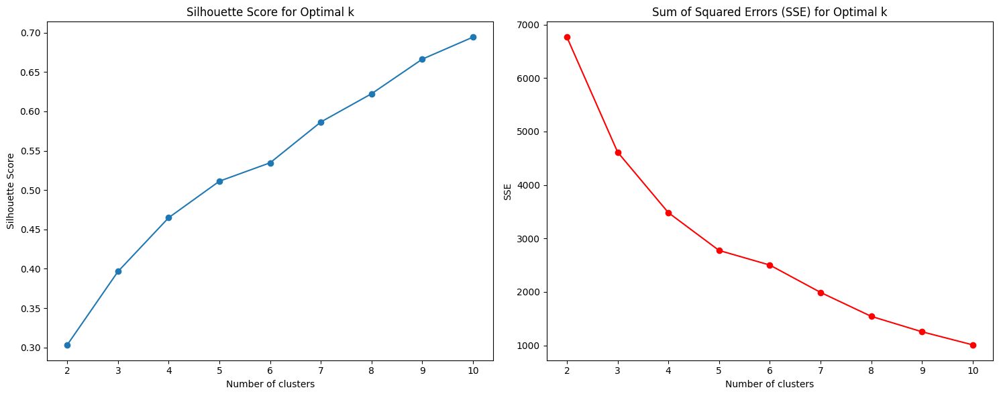

In [10]:
from sklearn.metrics import silhouette_score

silhouette_scores = []
sse_scores = []

for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, n_init='auto')
    kmeans.fit(X)
    
    silhouette_score_k = silhouette_score(X, kmeans.labels_)
    silhouette_scores.append(silhouette_score_k)
    
    sse_scores.append(kmeans.inertia_)  # Append SSE score

# Create a single plot with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# Plot Silhouette Scores
ax1.plot(range(2, 11), silhouette_scores, marker='o')
ax1.set_xlabel('Number of clusters')
ax1.set_ylabel('Silhouette Score')
ax1.set_title('Silhouette Score for Optimal k')

# Plot SSE Scores
ax2.plot(range(2, 11), sse_scores, marker='o', color='r')
ax2.set_xlabel('Number of clusters')
ax2.set_ylabel('SSE')
ax2.set_title('Sum of Squared Errors (SSE) for Optimal k')

plt.tight_layout()
plt.show()

Sto je vise klastera, veci je silhouette score, ali to moze da rezultuje u klasterima koji ne sadrze znacajne informacije, tako da cemo se zaustaviti na 6 klastera. 

In [11]:
kclusters = 6
kmeans = KMeans(n_clusters=kclusters, n_init='auto')
kmeans.fit(X)

KMeans(n_clusters=6, n_init='auto')

In [12]:
from matplotlib import colors

# Kreiranje mape
map_clusters = folium.Map(location=[latitude1, longitude1], zoom_start=4)

# Postavljanje boje za klaster
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = plt.cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

cluster_counts = [list(kmeans.labels_).count(label) for label in range(kclusters)]  # Broj instanci po klasterima

# Dodavanje legendi
legend_html = """
<div style="position: fixed; 
     bottom: 50px; left: 40px; width: 150px; height: 200px; 
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color:white;
     ">&nbsp; Cluster Legend <br>
     """

for i, color, count in zip(range(kclusters), rainbow, cluster_counts):
    legend_html += f"<i class='fa fa-circle' style='color:{color}'></i> Cluster {i}: {count}<br>"

legend_html += "</div>"

map_clusters.get_root().html.add_child(folium.Element(legend_html))

# Dodavanje markera na mapu
for lat, lon, poi, cluster_label in zip(df['latitude'], df['longitude'], df['title'], kmeans.labels_):
    label = folium.Popup(str(poi), parse_html=True)
    cluster_color = rainbow[cluster_label]
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=cluster_color,
        fill=True,
        fill_color=cluster_color,
        fill_opacity=0.7).add_to(map_clusters)

map_clusters




# Graficki prikaz klastera

In [13]:
pd.set_option('display.max_columns', None)

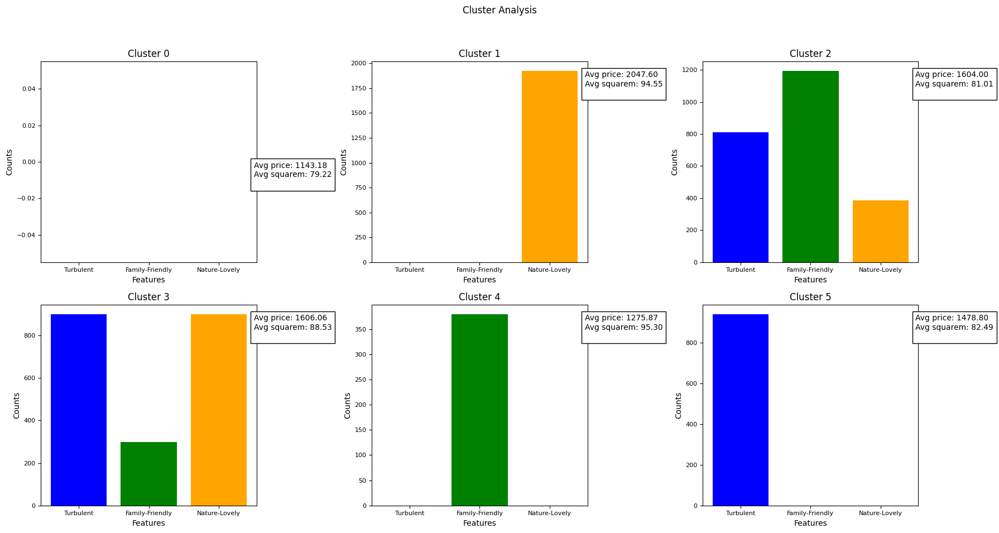

In [31]:
import matplotlib.pyplot as plt
import pandas as pd


# Podešavanje broja klastera
kclusters = 6

# Kreiranje glavnog platna sa potplotovima
fig, axes = plt.subplots(2, 3, figsize=(18, 10))
fig.suptitle('Cluster Analysis')

# Iteracija kroz klastera
for i in range(kclusters):
    Cluster_i = df[kmeans.labels_ == i]
    
    # Broj instanci sa turbulent = 1, family-friendly = 1 i nature-lovely = 1
    turbulent_count = Cluster_i['turbulent'].sum()
    family_friendly_count = Cluster_i['family-friendly'].sum()
    nature_lovely_count = Cluster_i['nature-lovely'].sum()
    
    # Odabir potplotova
    row = i // 3
    col = i % 3
    ax = axes[row, col]
    
    # Kreiranje grafa
    ax.set_title('Cluster {}'.format(i))
    ax.bar(['Turbulent', 'Family-Friendly', 'Nature-Lovely'],
           [turbulent_count, family_friendly_count, nature_lovely_count],
           color=['blue', 'green', 'orange'])
    
    # Prikaz prosečnih vrednosti kao tekst u gornjem desnom uglu
    avg_price = Cluster_i['price'].mean()
    avg_square_meters = Cluster_i['square_meters'].mean()
    
    box_text = f"Avg price: {avg_price:.2f}\n" \
                f"Avg squarem: {avg_square_meters:.2f}\n"
    
    ax.text(2.5, max([turbulent_count, family_friendly_count, nature_lovely_count]), box_text, va='top', ha='left', bbox=dict(facecolor='white', edgecolor='black'))
    
    # Podešavanje oznaka osa
    ax.set_xlabel('Features')
    ax.set_ylabel('Counts')
    ax.tick_params(axis='both', which='major', labelsize=8) 

# Prikaz grafova
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

In [26]:
Cluster_2 = df[kmeans.labels_ == 2]
Cluster_3 = df[kmeans.labels_ == 3]

luxury_2 = Cluster_2['luxury'].sum()
luxury_3 = Cluster_3['luxury'].sum()

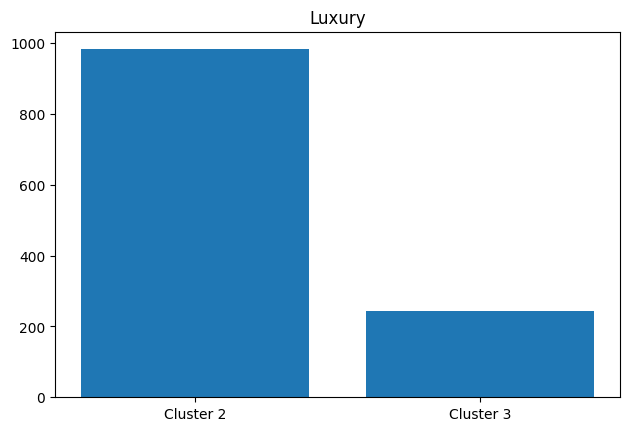

In [37]:
# da bismo videli razliku izmedju drugog i treceg klastera

# Kreiranje plota i subplotova
fig, ax = plt.subplots()

# Naslov
ax.set_title('Luxury')

# Barovi
ax.bar(['Cluster 2', 'Cluster 3'], [luxury_2, luxury_3])

# Vizuelizacija
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

# Analiza dobijenih rezultata

## Klaster 0 - najjeftiniji i najmanji

Kardinalnost: 2455  
Teritorija: Novi Meksiko, Teksas, Luizijana, Oklahoma, Arkansas, Misisipi, Alabama, Dzordzija, Juzna Karolina, Kansas, Misuri, Kentaki, Tenesi, Indijana, Ohajo, Micigen, Pensilvanija  
Dominanta kategorija: /  
Prosecna cena: 1120 dolara  
Prosecna kvadratura: oko 80 kvadrata  

## Klaster 1 - najskuplji i najveci

Kardinalnost: 1921  
Teritorija: Severna Karolina, Florida, Arizona, Kalifornija, Montana, Aljaska, Havaji  
Dominanta kategorija: Nature-lovely skoro u celosti  
Prosecna cena: oko 2050  dolara    
Prosecna kvadratura: oko 95 kvadrata  

## Klaster 2 - za svakog po nesto, luksuzni

Kardinalnost: 1192  
Teritorija: Nebraska, Ajova, Minesota, Njujork, Njudzersi, Konektikat, Masacusets, Vermont, Vasington  
Dominanta kategorija: Family-friendly  
Prosecna cena: 1600 dolara  
Prosecna kvadratura: oko 80 kvadrata  

## Klaster 3 - za svakog po nesto, klasicni

Kardinalnost: 899  
Teritorija: Vasington, Juta, Kolorado, Masacusets (oko Bostona)  
Dominanta kategorija: Turbulent + Nature-lovely  
Prosecna cena: oko 1600 dolara    
Prosecna kvadratura: oko 88 kvadrata    

## Klaster 4 - najbolji odnos cene i kvadrature

Kardinalnost: 2515 (najbrojniji klaster)
Teritorija:  Novi Meksiko, Teksas, Luizijana, Oklahoma, Arkansas, Misisipi, Alabama, Dzordzija, Juzna Karolina, Kansas, Misuri, Kentaki, Tenesi, Indijana, Ohajo, Micigen, Pensilvanija, Nevada, Ajdaho, Severna i Juzna Dakota, 
Dominanta kategorija: Family-friendly  
Prosecna cena: oko 1300 dolara  
Prosecna kvadratura: oko 95 kvadrata  

## Klaster 5 - za mlade

Kardinalnost: 940  
Teritorija: Vest Virdzinija, Njujork, Ilinoj, Viskonsin  
Dominanta kategorija: Turbulent  
Prosecna cena: oko 1500 dolara  
Prosecna kvadratura: oko 83 kvadrata 